# Transformasi Linier Brightness

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [55]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import numpy as np
import matplotlib.pyplot as plt


Mengubah tingkat kecerahan Citra
--------------------------------
Masukan nilai kecerahan: 50


/tmp/ipython-input-2598027542.py:15: RuntimeWarning: overflow encountered in scalar add
  brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)


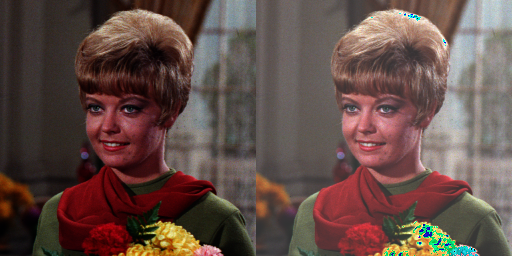

In [10]:
print('Mengubah tingkat kecerahan Citra')
print('--------------------------------')
try:
  brightness = int(input('Masukan nilai kecerahan: '))
except:
  print('Nilai harus berupa angka')

original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff')

brightness_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

# TUGAS PRAKTIKUM D1

## 1. Implementasikan inverse citra pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori, sehingga menghasilkan keluaran seperti berikut:

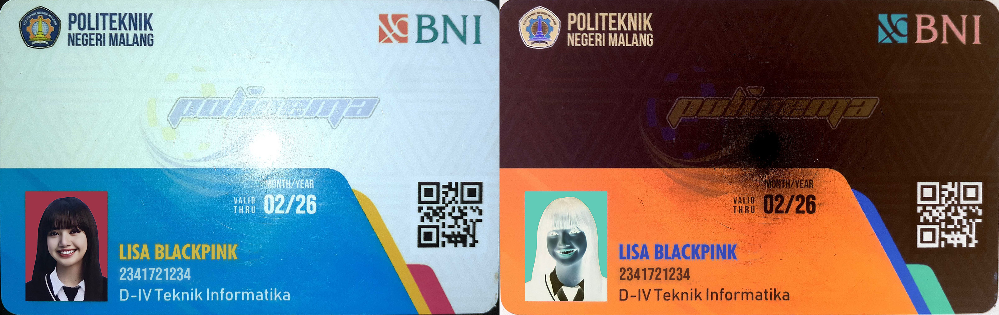

In [28]:
ktm = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Week2/images/lisa_ktm.jpg')
ktm_inverse = cv.bitwise_not(ktm)

final_ktm = cv.hconcat((ktm, ktm_inverse))
cv2_imshow(final_ktm)


## 2. Implementasikan transformasi contrast pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori untuk kontras,

Mengubah tingkat kecerahan & kontras Citra
--------------------------------
Masukan nilai kecerahan: 50
Masukan nilai kontras: 3


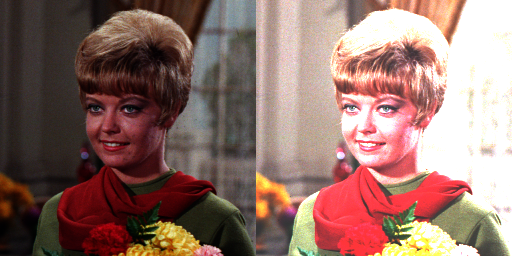

In [47]:
print('Mengubah tingkat kecerahan & kontras Citra')
print('--------------------------------')

try:
    brightness = int(input('Masukan nilai kecerahan: '))
except:
    print('Nilai harus berupa angka')
    brightness = 0

try:
    contrast = float(input('Masukan nilai kontras: '))
except:
    print('Nilai harus berupa angka')
    contrast = 1.0

# Baca citra
original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff')

adjusted_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      adjusted_image[y,x,c] = np.clip(original[y,x,c] * contrast + brightness, 0, 255)

final_frame = cv.hconcat((original, adjusted_image))
cv2_imshow(final_frame)

Cara lain:

## 3. Implementasikan transformasi logarithmic brightness pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori untuk transformasi log,

Mengubah tingkat kecerahan Citra
--------------------------------
Masukan nilai kecerahan: 50


/tmp/ipython-input-40420045.py:22: RuntimeWarning: overflow encountered in scalar add
  s = c * math.log(1 + r + brightness)


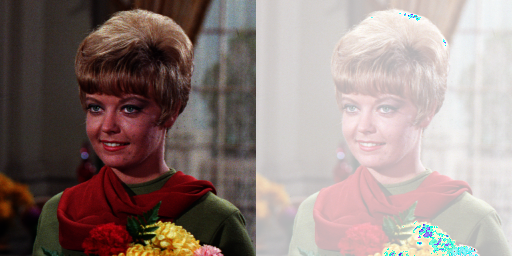

In [58]:
import math

print('Mengubah tingkat kecerahan Citra')
print('--------------------------------')
try:
  brightness = int(input('Masukan nilai kecerahan: '))
except:
  print('Nilai harus berupa angka')

original = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Asset_PCVK/female.tiff')

brightness_image = np.zeros(original.shape, dtype=np.uint8)

# Konstanta c
c = 255 / np.log(1 + np.max(original))

for y in range(original.shape[0]):
    for x in range(original.shape[1]):
        for c_channel in range(original.shape[2]):
            r = original[y, x, c_channel]
            s = c * math.log(1 + r + brightness)
            brightness_image[y, x, c_channel] = np.clip(s, 0, 255)

final_frame = cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

## 4. Implementasikan transformasi grayscale menggunakan metode averaging, lightness, dan luminance pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori

In [67]:
ktm = cv.imread('/content/drive/MyDrive/KULIAH SEMESTER 5/Pengolahan Citra dan Visi Komputer/Week2/images/lisa_ktm.jpg')
ktm_lisa = cv.cvtColor(ktm, cv.COLOR_BGR2RGB)

### a. Averaging

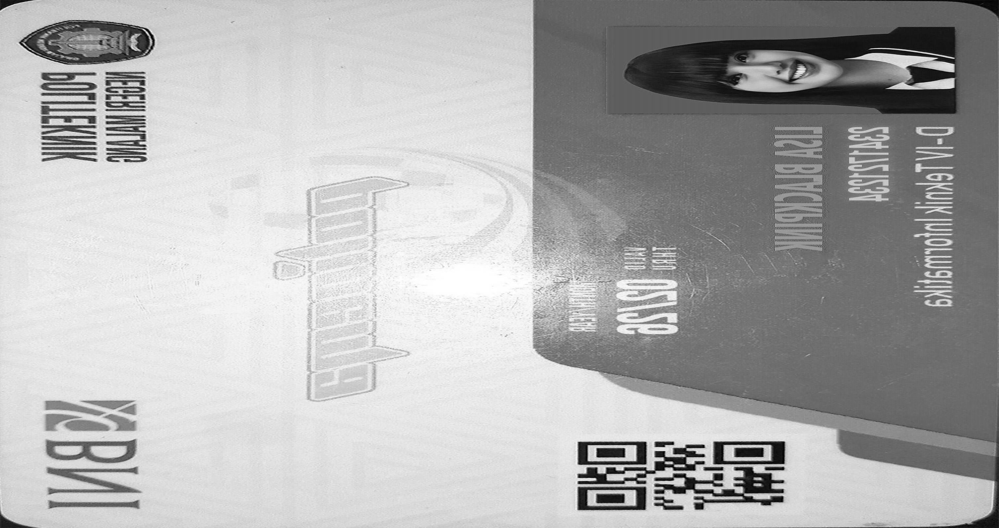

In [70]:
ktm_lisa_gray_avg = np.zeros((ktm_lisa.shape[0], ktm_lisa.shape[1]), dtype=np.uint8)

for y in range(ktm_lisa.shape[0]):
    for x in range(ktm_lisa.shape[1]):
        ktm_lisa_gray_avg[y, x] = np.mean(ktm_lisa[y, x])

# Ubah grayscale ke 3 channel biar bisa concat
ktm_lisa_gray_avg_bgr = cv.cvtColor(ktm_lisa_gray_avg, cv.COLOR_GRAY2BGR)

final_ktm_gray_avg = cv.hconcat(ktm_lisa, ktm_lisa_gray_avg_bgr)
cv2_imshow(final_ktm_gray_avg)

### b.lightness

/tmp/ipython-input-2340928718.py:9: RuntimeWarning: overflow encountered in scalar add
  gray_val = (max(R, G, B) + min(R, G, B)) // 2


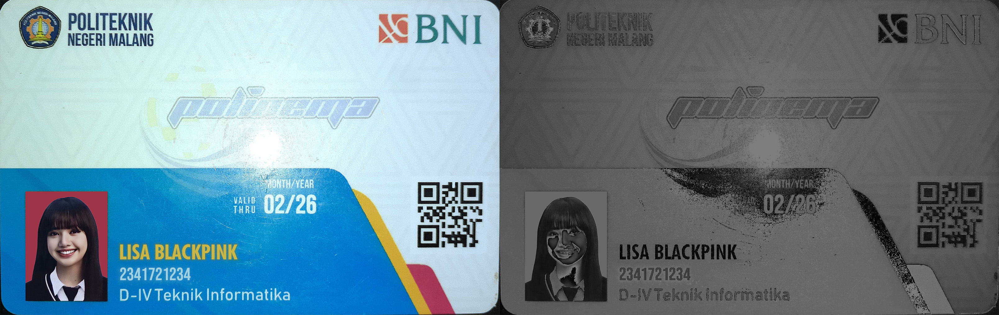

In [65]:
ktm_lisa_gray_li𝑔ℎ𝑡𝑛𝑒𝑠𝑠 = np.zeros((ktm_lisa.shape[0], ktm_lisa.shape[1]), dtype=np.uint8)

# Loop pixel per pixel
for y in range(ktm_lisa.shape[0]):
    for x in range(ktm_lisa.shape[1]):
        B = ktm_lisa[y, x, 0]
        G = ktm_lisa[y, x, 1]
        R = ktm_lisa[y, x, 2]
        gray_val = (max(R, G, B) + min(R, G, B)) // 2
        ktm_lisa_gray_lightness[y, x] = gray_val

final_ktm_gray_avg = cv.hconcat((ktm_lisa, cv.cvtColor(ktm_lisa_gray_l𝑖𝑔ℎ𝑡𝑛𝑒𝑠𝑠, cv.COLOR_GRAY2BGR)))
cv2_imshow(final_ktm_gray_avg)

### c. Luminance

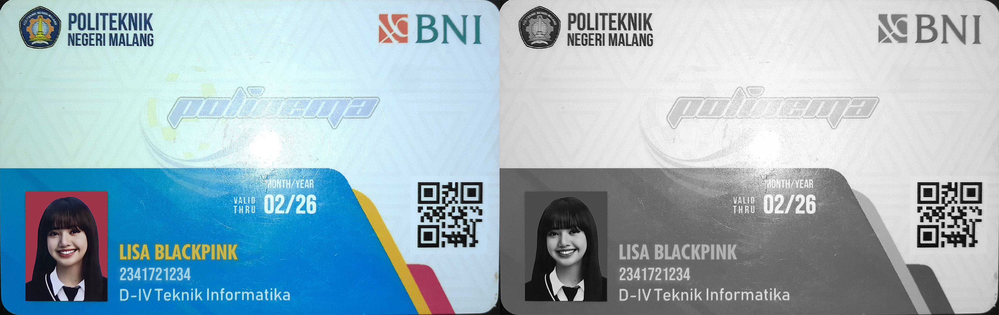

In [66]:
ktm_lisa_gray_luminance = np.zeros((ktm_lisa.shape[0], ktm_lisa.shape[1]), dtype=np.uint8)

# Loop pixel per pixel
for y in range(ktm_lisa.shape[0]):
    for x in range(ktm_lisa.shape[1]):
        B = ktm_lisa[y, x, 0]
        G = ktm_lisa[y, x, 1]
        R = ktm_lisa[y, x, 2]
        gray_val = (0.21 * R) + (0.72 * G) + (0.07 * B)
        ktm_lisa_gray_luminance[y, x] = gray_val

final_ktm_gray_avg = cv.hconcat((ktm_lisa, cv.cvtColor(ktm_lisa_gray_luminance, cv.COLOR_GRAY2BGR)))
cv2_imshow(final_ktm_gray_avg)